# Combating Agansit Organ Traffiking USING knowledge Graph and Machine learning

In this notebook we cleaned the textual data and then extracted the NER and built the realtions and then we draw the knowledge graph by cleaning it for the duplicate entities and the relations. We also took the bigrams and trigrams so that most number of reltions can be understand. It should be noted that we converted the graph in to weight KG and then we did the above manipulation on the grap.



# Importing the required libraries

In [ ]:
import spacy
import nltk
from nltk.tokenize import sent_tokenize
from spacy import displacy
from collections import defaultdict
import pandas as pd
from collections import Counter
# Load the SpaCy model
nlp = spacy.load("en_core_web_sm")
nlp.add_pipe("merge_noun_chunks")


<function spacy.pipeline.functions.merge_noun_chunks(doc: spacy.tokens.doc.Doc) -> spacy.tokens.doc.Doc>

In [ ]:
import re
import pandas as pd
import bs4
import requests
from spacy import displacy
#nlp = spacy.load('en_core_web_sm')

from spacy.matcher import Matcher 
from spacy.tokens import Span 

import networkx as nx

import matplotlib.pyplot as plt
from tqdm import tqdm
import pandas as pd
pd.set_option('display.max_colwidth', 200)
%matplotlib inline

In [ ]:
import string
from nltk.corpus import stopwords 
from nltk.tokenize import RegexpTokenizer
from nltk.stem import WordNetLemmatizer
from nltk.stem.porter import PorterStemmer

In [ ]:
df = pd.read_csv("/content/drive/MyDrive/Cases in Pakistan and in India  updated.xlsx - Sheet1.csv",encoding= 'unicode_escape')
df

,article
0,"Informal labourers, who are in severe debt due to loss of livelihood due to the pandemic, are the larger chunk who sell their organs Just as India and its health system limp back to a semblance of..."
1,"NEW DELHI (Thomson Reuters Foundation) - The chief executive, medical director and three other doctors at a prestigious Indian hospital have been charged with offences related to illegal organ tra..."
2,"Reporting from Mumbai, India â Seven years after leaving his village in northern India to find work in the bursting metropolis of Mumbai, Sundar Singh Jatav was struggling in a menial job at a ..."
3,Police in Pakistan said Friday they busted an organ trafficking ring when a missing 14-year-old boy was found in an underground lab after having his kidney removed.\n\nThe ring was responsible for...
4,"The gang's victims were taken to a medical testing lab used for clandestine organ transplant surgeries in the garrison city of Rawalpindi, near the capital Islamabad.\n\nFacilities for such clande..."
5,"Illegal kidney trade in the country recently came to light when a new and upscale hospital in Mumbai reported four cases of dubious organ transplant.While the key player in the kidney racket, Bije..."
6,"For a hospital, this centre for kidney transplants appears to have a lot of secrets.\n\nâNo photography allowedâ, reads a prominently displayed notice by the entrance.\n\nIn the waiting room, ..."
7,"In 2002, Kenam Tamang was duped into parting with a kidney by his own son-in-law. The ruse was a simple one, sweetened by the lure of work and a steady income â something he had been bereft of f..."
8,LAHORE: A family on Monday lodged a complaint with the Federal Investigation Agency (FIA) alleging that the doctors involved in the illegal organ transplant had âkilledâ its boy during the pro...
9,LAHORE: The Federal Investigation Agency (FIA) on Tuesday arrested another agent in connection with the illegal organ trade in the city.\n\nAn FIA team headed by Deputy Director Jamil Ahmad Khan M...


# Data Cleaning 
We did the data cleaning by the following way such as:




*   Removal of Punctuaion Marks
*   Tokenization


*   Removal of Stop words 
*   Lemmatization and Stemming






In [ ]:
def remove_punctuation(test_str):
# Using filter() and lambda function to filter out punctuation characters

  result = ''.join(filter(lambda x: x.isalpha() or x.isdigit() or x.isspace(), test_str))

  return result

In [ ]:
df["new_article"] = df['article'].str.replace('[^\w\s]','')

<ipython-input-7-2905f598e020>:1: FutureWarning: The default value of regex will change from True to False in a future version.
  df["new_article"] = df['article'].str.replace('[^\w\s]','')


In [ ]:
df['article']

0     Informal labourers, who are in severe debt due to loss of livelihood due to the pandemic, are the larger chunk who sell their organs Just as India and its health system limp back to a semblance of...
1     NEW DELHI (Thomson Reuters Foundation) - The chief executive, medical director and three other doctors at a prestigious Indian hospital have been charged with offences related to illegal organ tra...
2     Reporting from Mumbai, India â  Seven years after leaving his village in northern India to find work in the bursting metropolis of Mumbai, Sundar Singh Jatav was struggling in a menial job at a ...
3     Police in Pakistan said Friday they busted an organ trafficking ring when a missing 14-year-old boy was found in an underground lab after having his kidney removed.\n\nThe ring was responsible for...
4     The gang's victims were taken to a medical testing lab used for clandestine organ transplant surgeries in the garrison city of Rawalpindi, near the capital Islamabad.\n\n

In [ ]:
tokenizer = RegexpTokenizer(r'\w+')
df['article']=df['new_article'].apply(lambda x:tokenizer.tokenize(x.lower()))
df['article']

0     [informal, labourers, who, are, in, severe, debt, due, to, loss, of, livelihood, due, to, the, pandemic, are, the, larger, chunk, who, sell, their, organs, just, as, india, and, its, health, syste...
1     [new, delhi, thomson, reuters, foundation, the, chief, executive, medical, director, and, three, other, doctors, at, a, prestigious, indian, hospital, have, been, charged, with, offences, related,...
2     [reporting, from, mumbai, india, â, seven, years, after, leaving, his, village, in, northern, india, to, find, work, in, the, bursting, metropolis, of, mumbai, sundar, singh, jatav, was, strugglin...
3     [police, in, pakistan, said, friday, they, busted, an, organ, trafficking, ring, when, a, missing, 14yearold, boy, was, found, in, an, underground, lab, after, having, his, kidney, removed, the, r...
4     [the, gangs, victims, were, taken, to, a, medical, testing, lab, used, for, clandestine, organ, transplant, surgeries, in, the, garrison, city, of, rawalpindi, near, the,

In [ ]:
def remove_stopwords(text):
  words = [w for w in text if w not in stopwords.words('english')]
  return words
  

In [ ]:
import nltk 
nltk.download('stopwords')

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.


True

In [ ]:
stopword = nltk.corpus.stopwords.words('english')
print(stopword[:11])

['i', 'me', 'my', 'myself', 'we', 'our', 'ours', 'ourselves', 'you', "you're", "you've"]


In [ ]:
df['article'] = df['article'].apply(lambda x:remove_stopwords(x))
df['article']

0     [informal, labourers, severe, debt, due, loss, livelihood, due, pandemic, larger, chunk, sell, organs, india, health, system, limp, back, semblance, normality, devastation, covid, old, scandal, re...
1     [new, delhi, thomson, reuters, foundation, chief, executive, medical, director, three, doctors, prestigious, indian, hospital, charged, offences, related, illegal, organ, transplants, kidney, traf...
2     [reporting, mumbai, india, â, seven, years, leaving, village, northern, india, find, work, bursting, metropolis, mumbai, sundar, singh, jatav, struggling, menial, job, video, game, shop, 250, dail...
3     [police, pakistan, said, friday, busted, organ, trafficking, ring, missing, 14yearold, boy, found, underground, lab, kidney, removed, ring, responsible, luring, young, vulnerable, victims, promise...
4     [gangs, victims, taken, medical, testing, lab, used, clandestine, organ, transplant, surgeries, garrison, city, rawalpindi, near, capital, islamabad, facilities, clandest

In [ ]:
lemmatizer = WordNetLemmatizer()
def Word_Lemmatizer(text):
  lem_text = [lemmatizer.lemmatize(i) for i in text]
  return lem_text

In [ ]:
import nltk 
nltk.download('wordnet')
nltk.download('omw-1.4')

[nltk_data] Downloading package wordnet to /root/nltk_data...
[nltk_data] Downloading package omw-1.4 to /root/nltk_data...


True

In [ ]:
df['article'] = df['article'].apply(lambda x:Word_Lemmatizer(x))
df['article']

0     [informal, labourer, severe, debt, due, loss, livelihood, due, pandemic, larger, chunk, sell, organ, india, health, system, limp, back, semblance, normality, devastation, covid, old, scandal, resu...
1     [new, delhi, thomson, reuters, foundation, chief, executive, medical, director, three, doctor, prestigious, indian, hospital, charged, offence, related, illegal, organ, transplant, kidney, traffic...
2     [reporting, mumbai, india, â, seven, year, leaving, village, northern, india, find, work, bursting, metropolis, mumbai, sundar, singh, jatav, struggling, menial, job, video, game, shop, 250, daily...
3     [police, pakistan, said, friday, busted, organ, trafficking, ring, missing, 14yearold, boy, found, underground, lab, kidney, removed, ring, responsible, luring, young, vulnerable, victim, promise,...
4     [gang, victim, taken, medical, testing, lab, used, clandestine, organ, transplant, surgery, garrison, city, rawalpindi, near, capital, islamabad, facility, clandestine, s

In [ ]:
stemmer = PorterStemmer()

In [ ]:
def word_stemmer(text):
  stem_text = " ".join([stemmer.stem(i) for i in text])
  return stem_text

In [ ]:
clean_df = df['article'].apply(lambda x: word_stemmer(x))
clean_df

0     inform labour sever debt due loss livelihood due pandem larger chunk sell organ india health system limp back semblanc normal devast covid old scandal resurfac india one global epicentr traffick o...
1     new delhi thomson reuter foundat chief execut medic director three doctor prestigi indian hospit charg offenc relat illeg organ transplant kidney traffick racket uncov polic spokesman said oper pr...
2     report mumbai india â seven year leav villag northern india find work burst metropoli mumbai sundar singh jatav struggl menial job video game shop 250 daili wage hardli enough famili back home dee...
3     polic pakistan said friday bust organ traffick ring miss 14yearold boy found underground lab kidney remov ring respons lure young vulner victim promis lucr job larg payout remov organ â mainli kid...
4     gang victim taken medic test lab use clandestin organ transplant surgeri garrison citi rawalpindi near capit islamabad facil clandestin surgeri pakistan often lack proper

In [ ]:
cleaned_text = str(clean_df.tolist())
Doc = cleaned_text

# Visualization of Dependecny Parser Using Displacy 

In [ ]:
 doc= nlp(cleaned_text)
displacy.render(doc, style='dep',jupyter = True, options = {'distance':140})

# Entity Visualization using Displacy

In [ ]:
doc = nlp(cleaned_text)
displacy.render(doc,style='ent',jupyter=True)

In [ ]:
!pip install fuzzywuzzy

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


# Building the Knowledge Graph Extraction of NER AND Building Relationships

In [ ]:
# Import necessary libraries
import pandas as pd
import networkx as nx
import matplotlib.pyplot as plt
from fuzzywuzzy import fuzz
from itertools import tee, zip_longest
from collections import Counter

# Function to generate n-grams
def generate_ngrams(tokens, n):
    ngrams = zip(*[tokens[i:] for i in range(n)])
    return [" ".join(ngram) for ngram in ngrams]

# Filter relevant entities
entities = []  # List to store entities
for ent in doc.ents:
    # Filter entities based on relevant criteria, e.g., entity type, confidence score, etc.
    if ent.label_ in ['ORG', 'PERSON', 'LOCATION']:
        entities.append((ent.text, ent.label_))

# Create edges based on relationships
edges = []  # List to store edges
for i in range(len(entities)):
    for j in range(i + 1, len(entities)):
        edges.append((entities[i][0], entities[j][0]))

# Create a DataFrame for the knowledge graph
kg_df = pd.DataFrame({"source": [i[0] for i in edges], "target": [i[1] for i in edges], "edge": "related"})



# Knowledge graph Cleaning 




In [ ]:
# Data matching to clean and deduplicate entities and relationships
# Calculate similarity scores for entity text using fuzzy string matching
entity_similarity_threshold = 80  # Set similarity threshold for considering entities as duplicates
entities_df = pd.DataFrame(entities, columns=["entity", "label"])
entities_df["similarity"] = entities_df["entity"].apply(lambda x: fuzz.ratio(x, entities_df["entity"].iloc[0]))

# Drop duplicate entities based on similarity scores and threshold
entities_df.drop_duplicates(subset="entity", inplace=True)
entities_df = entities_df[entities_df["similarity"] >= entity_similarity_threshold]

# Entity resolution to merge similar entities
# Group entities based on similarity scores and label
entity_groups = entities_df.groupby(["label"])
merged_entities = []
for _, group in entity_groups:
    merged_entities += group["entity"].unique().tolist()

# Replace entities in the knowledge graph with merged entities
kg_df["source"] = kg_df["source"].apply(lambda x: x if x not in merged_entities else merged_entities[0])
kg_df["target"] = kg_df["target"].apply(lambda x: x if x not in merged_entities else merged_entities[0])

# Data validation to clean and validate relationships
# Drop duplicate edges based on source and target
kg_df.drop_duplicates(subset=["source", "target"], inplace=True)

# Visualizing the Knowledge Graph

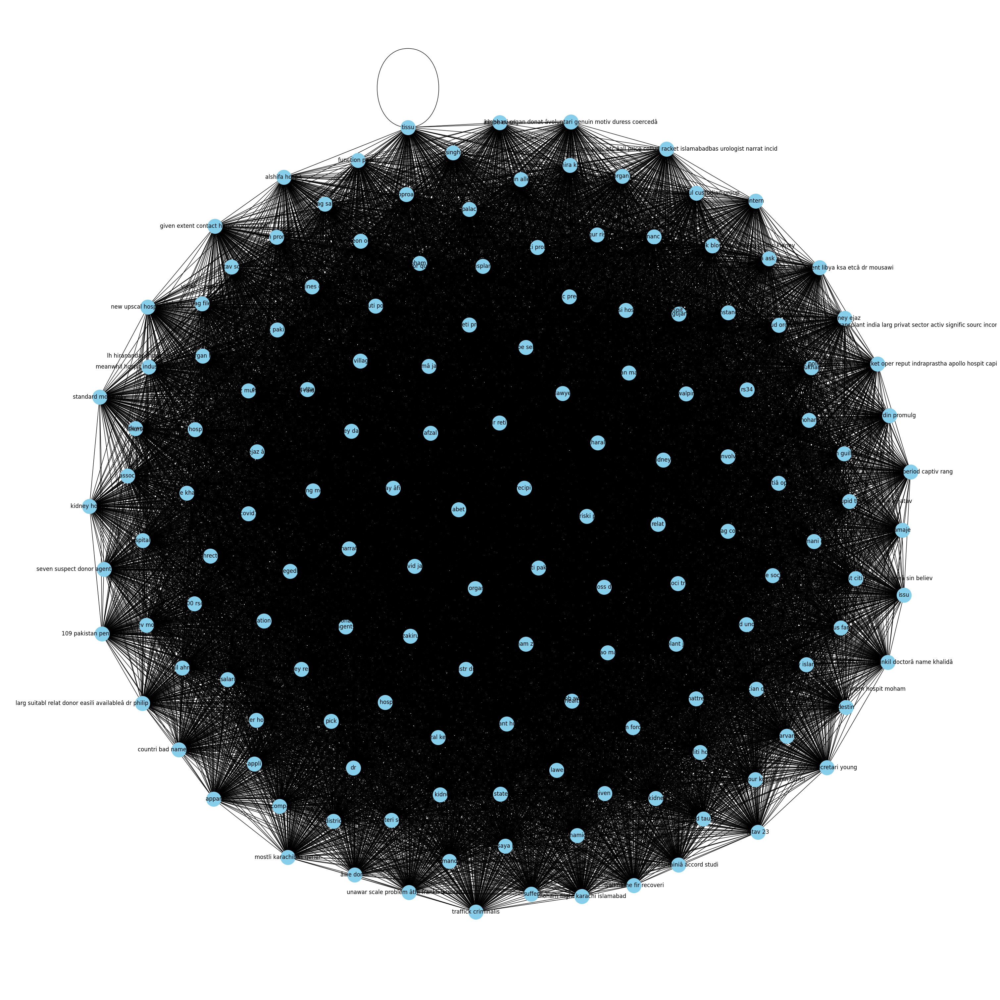

In [ ]:
# Build the knowledge graph
G = nx.Graph()
G.add_nodes_from(entities_df["entity"])
G.add_edges_from(kg_df[["source", "target"]].values)

# Visualize the initial knowledge graph
plt.figure(figsize=(30, 30))
pos = nx.spring_layout(G, k=0.5)
nx.draw(G, with_labels=True, node_color='skyblue', node_size=1000, edge_cmap=plt.cm.Blues, pos=pos)
plt.show()

In [ ]:
entities

[('againgiven miseri', 'PERSON'),
 ('worryingli covid19 pandem', 'PERSON'),
 ('lesser amount broker provok blow whistl alleg destin kidney', 'PERSON'),
 ('certain hospit calcutta latecom lucr busi', 'PERSON'),
 ('even collus driven revenu transplant gener privat sector healthcar profess refus collud organ sell come halt transplant india larg privat sector activ signific sourc incom hospit',
  'PERSON'),
 ('qualiti hospit', 'ORG'),
 ('mechan punish guilti donor broker', 'ORG'),
 ('relat', 'PERSON'),
 ('lh hiranandani hospit mumbai organ harvest ring bust polic juli follow',
  'PERSON'),
 ('recent month june polic discov similar racket oper reput indraprastha apollo hospit capit',
  'ORG'),
 ('neighbor gujarat state traffick allegedli', 'PERSON'),
 ('singh', 'PERSON'),
 ('solv financi problem jatav', 'PERSON'),
 ('sell kidneyâ', 'PERSON'),
 ('jatav 23', 'PERSON'),
 ('provid jatav', 'PERSON'),
 ('themâ jatav', 'PERSON'),
 ('better job sweeten deal sandeep move jatav sleep mattress corner 

# Bigrams and Trigrams

In [ ]:
# Extract tokens from doc
tokens = [token.text for token in doc if not token.is_stop and not token.is_punct]

# Generate bigrams and trigrams
bigrams = pd.Series(list(zip(tokens, tokens[2:]))).value_counts()
trigrams = pd.Series(list(zip(tokens, tokens[2:], tokens[2:]))).value_counts()

In [ ]:
bigrams

(develop, said)        4
(human, tissu)         4
(said, said)           4
(transplant, organ)    4
(work, day)            2
                      ..
(epidur, condit)       1
(anaesthet, â)         1
(condit, describ)      1
(â, terribl)           1
(shield, flourish)     1
Length: 3633, dtype: int64

In [ ]:
trigrams

(develop, said, said)           4
(human, tissu, tissu)           4
(said, said, said)              4
(transplant, organ, organ)      4
(work, day, day)                2
                               ..
(epidur, condit, condit)        1
(anaesthet, â, â)               1
(condit, describ, describ)      1
(â, terribl, terribl)           1
(shield, flourish, flourish)    1
Length: 3633, dtype: int64

In [ ]:
# Print bigrams and trigrams
print("Bigrams:")
print(bigrams.head(10))  # Print top 10 bigrams
print("\nTrigrams:")
print(trigrams.head(10))


Bigrams:
(develop, said)        4
(human, tissu)         4
(said, said)           4
(transplant, organ)    4
(work, day)            2
(kidney, said)         2
(use, kidney)          2
(dr, dr)               2
(dr, told)             2
(took, week)           2
dtype: int64

Trigrams:
(develop, said, said)         4
(human, tissu, tissu)         4
(said, said, said)            4
(transplant, organ, organ)    4
(work, day, day)              2
(kidney, said, said)          2
(use, kidney, kidney)         2
(dr, dr, dr)                  2
(dr, told, told)              2
(took, week, week)            2
dtype: int64


# Querying for the certain cases

We queried for the certain cases such as:


*   Jatav's Case 
*   DR Althmash Racket 




*   Kott Momin or Tasleem Bibi Case







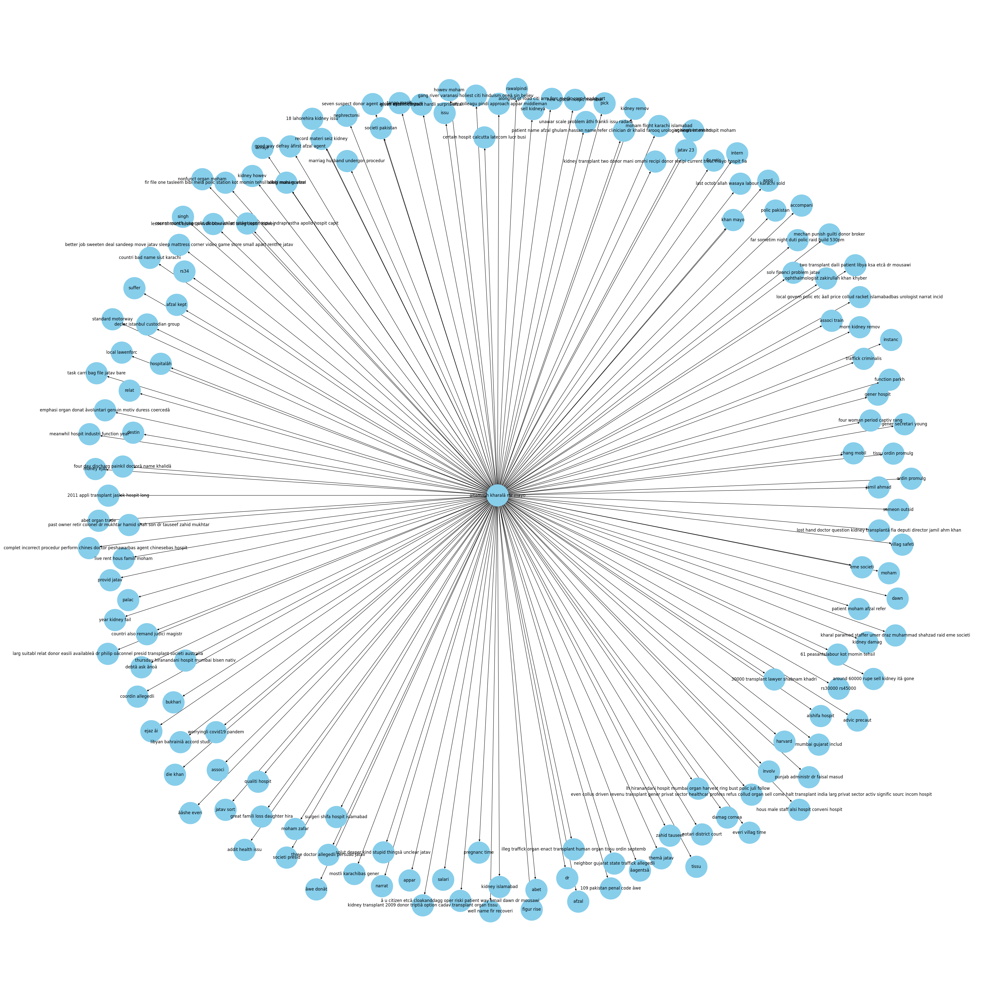

In [ ]:
# Query the knowledge graph for a specific entity
query = "altamash kharalâ mr mayo"
related_nodes = list(G.neighbors(query))
related_edges = [(query, node) for node in related_nodes]
related_edges_df = pd.DataFrame({"source": [i[0] for i in related_edges], "target": [i[1] for i in related_edges], "edge": "related"})
related_G = nx.from_pandas_edgelist(related_edges_df, "source", "target", edge_attr=True, create_using=nx.MultiDiGraph())

# Visualize the related graph using matplotlib
plt.figure(figsize=(40,40))
pos = nx.spring_layout(related_G, k = 0.5)
nx.draw(related_G, with_labels=True, node_color='skyblue', node_size=4000, edge_cmap=plt.cm.Blues, pos = pos)
plt.show()

During the process of analysis, we came to know that DR Altmash Kharal with the DR FAWAD Mumtaz who was running a very well-organized racket of organ trafficking in Pakistan and in Gulf was the partner of his racket we also came to know that during the process off transplant of the international person Muhammed Bin Rashid Altmash Kharal was with him. DR Altmash Kharal who was the young doctor in Lahore was caught by FIA in Lahore. The querying of the graph shows that all nodes and the connections of it with the cases which has been reported and the victims of the racket. 

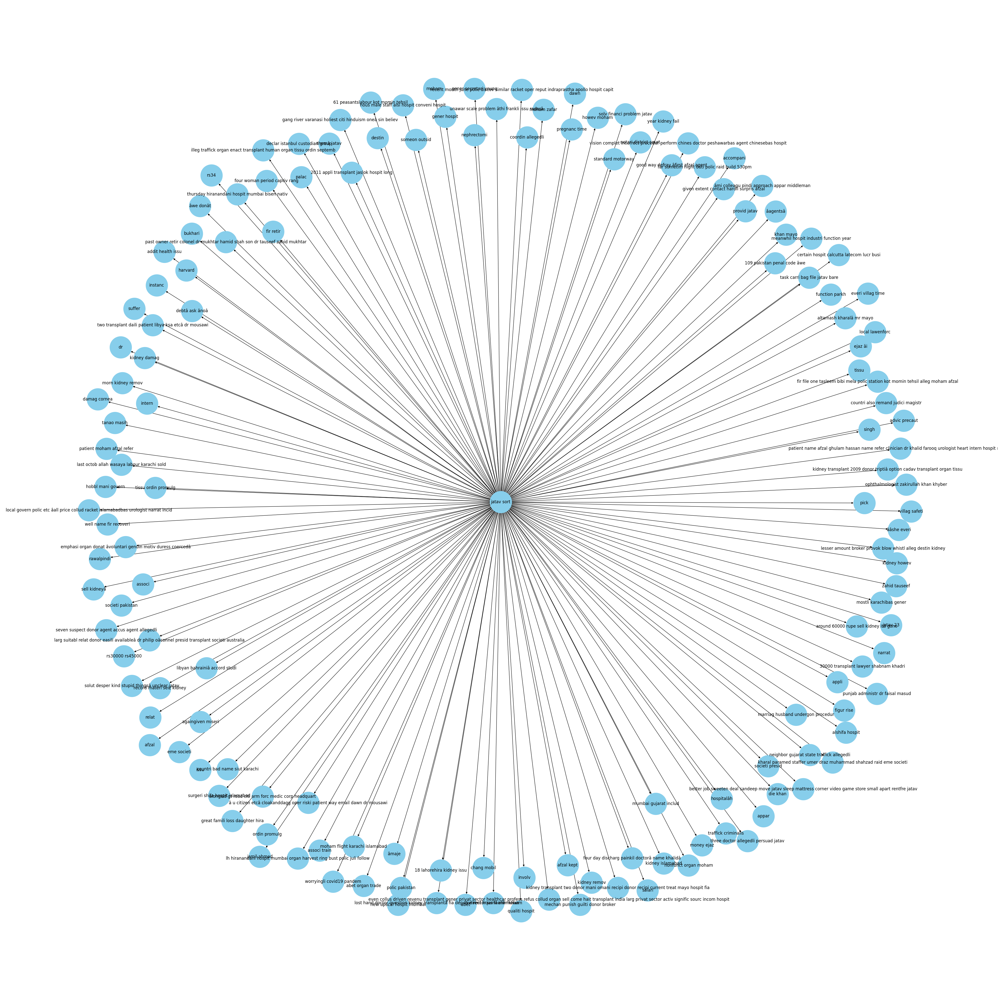

In [ ]:
# Query the knowledge graph for a specific entity
query = "jatav sort"
related_nodes = list(G.neighbors(query))
related_edges = [(query, node) for node in related_nodes]
related_edges_df = pd.DataFrame({"source": [i[0] for i in related_edges], "target": [i[1] for i in related_edges], "edge": "related"})
related_G = nx.from_pandas_edgelist(related_edges_df, "source", "target", edge_attr=True, create_using=nx.MultiDiGraph())

# Visualize the related graph using matplotlib
plt.figure(figsize=(40,40))
pos = nx.spring_layout(related_G, k = 0.5)
nx.draw(related_G, with_labels=True, node_color='skyblue', node_size=4000, edge_cmap=plt.cm.Blues, pos = pos)
plt.show()

Sundar Singh Jatav from Mumbai India sold his Kidney to pay the debt which he took. Jatav who was in severe need of money was earning 2.50 dollars per day. Then through his boss Jatav was approached by the organ traffik racket and when he listened to them, he shocked. When on investigation the Jatav revealed a great organ trafficking racket in one of the biggest hospitals in Indian financial capital then 14 people has been arrested including surgeons and paramedical staff who were involved in this. The ring which was arrested in the hospital was the part of the racket known as “Great Indian Kidney Racket”. It also reveals the that as in India most of the kidneys has been taken from the dead person. But a serious and surprising thing also came here that most of the transplant here which took place involve the living donors and every person is almost living with one kidney.Here Sundar Singh Jatav who was the victim all his connections that how he met with the middleman of the racket? How we were taken into the hospital? what are the reasons of selling his kidney? All things are placed by the directed graph, and it also shown the other potential nodes which may involve directly or indirectly in the case which means that our graph is not showing us the relevant case but also revealing the links with other rackets as well. The case revealed and by the help of the Graph it has been revealed that the family was in debt more than 10000 dollars and the only hope of the Jatav’s family was himself. Therefore, he sold out his kidney. Jatav Told that he saw a 30-year-old woman who was the recipient of the kidney. 
Most importantly Jatav Revealed that the Govt official of Indian National congress connected him this whole process which shows that the connections and the rackets somehow are also run by some corrupt politicians as well.


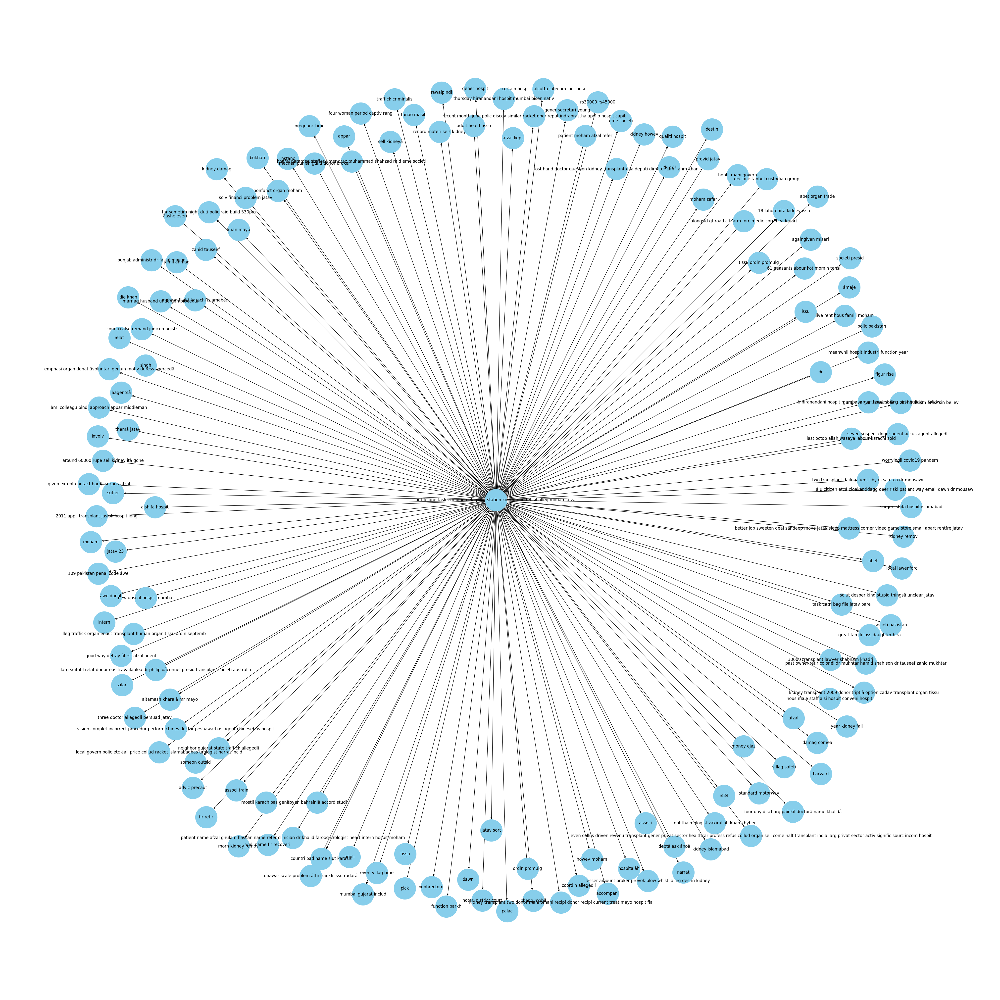

In [ ]:
# Query the knowledge graph for a specific entity
query = "fir file one tasleem bibi mela polic station kot momin tehsil alleg moham afzal"
related_nodes = list(G.neighbors(query))
related_edges = [(query, node) for node in related_nodes]
related_edges_df = pd.DataFrame({"source": [i[0] for i in related_edges], "target": [i[1] for i in related_edges], "edge": "related"})
related_G = nx.from_pandas_edgelist(related_edges_df, "source", "target", edge_attr=True, create_using=nx.MultiDiGraph())

# Visualize the related graph using matplotlib
plt.figure(figsize=(40,40))
pos = nx.spring_layout(related_G, k = 0.5)
nx.draw(related_G, with_labels=True, node_color='skyblue', node_size=4000, edge_cmap=plt.cm.Blues, pos = pos)
plt.show()

In a Sargodha a district in Pakistan in a village a lady named as Tasleem Bibi whose case is very sensitive. Tasleem Bibi had to pay the debt of 100,000 due to which she was in dire need of money having four children to feed and to earn livelihood for the house. She sold her kidney for the price of 110,000. A middleman approached the woman and being informed by the neighbor as well about the kidney selling.
The worst case is now that her son of age 15 is planning to sell his kidney which makes the situation to much alarming. The following graph shows all potential nodes which are directly connected to the woman case.
